In [62]:
from storage_env import StorageEnv
from stable_baselines3 import PPO
import grid2op
import numpy as np
import plotly.express as px
from stable_baselines3.common.base_class import BaseAlgorithm
import os
import pandas as pd

from A_train_ppo import MAIN_FOLDER

NB_RUN = 10

In [63]:
# env_g2op = grid2op.make("educ_case14_storage", test=True)
env_g2op = grid2op.make("l2rpn_idf_2023", test=True)
# env_g2op = grid2op.make("l2rpn_wcci_2022", test=True)

env = StorageEnv(env_g2op.max_episode_duration(),
                 env_g2op.n_storage,
                 env_g2op.storage_Emin,
                 env_g2op.storage_Emax,
                # np.array([24, 48, 48, 24, 24, 48, 48]),
                 env_g2op.storage_max_p_prod,
                 init_storage_capa_ratio=(0.1, 0.9),
                 ratio_setpoint=(0.2, 12),
                 smooth=6,
                #  target_shape="step_function",
                 target_shape="random_walk",
                 )

env._emax, env._maxP

/data/boguslawskieva_data/L2RPN-WCCI-Baselines/venv_baselines_dev/lib/python3.8/site-packages/grid2op/MakeEnv/Make.py:420: UserWarning:

You are using a development environment. This environment is not intended for training agents. It might not be up to date and its primary use if for tests (hence the "test=True" you passed as argument). Use at your own risk.



(array([48., 24., 48., 24., 48., 48., 24.], dtype=float32),
 array([12., 12., 12., 12., 12., 12., 12.], dtype=float32))

In [64]:
def act_expert(env, obs):
    obs_unnorm = np.concatenate((obs[:env.nb_storage] * env._emax, obs[env.nb_storage:] * env._emax))
    return np.clip((obs_unnorm[env.nb_storage:] - obs_unnorm[:env.nb_storage]) *12. / env._maxP, -1, 1)

def eval_one(env, agent, seed=0, nb_run=NB_RUN):
    env.seed(0)
    states = np.zeros((nb_run, env.episode_duration + 1, env.nb_storage))
    actions = np.full((nb_run, env.episode_duration + 1, env.nb_storage), np.nan)
    target = np.zeros((nb_run, env.episode_duration + 1, env.nb_storage))
    rewards = np.zeros((nb_run, env.episode_duration + 1))
    env.seed(0)
    for run_id in range(nb_run):
        obs, _ = env.reset()
        target[run_id, env.nb_iter, :] =  env._target_norm[env.nb_iter, :] * env._emax
        states[run_id, env.nb_iter, :] =  env._storage_charge
        while True:
            if isinstance(agent, BaseAlgorithm):
                action, _ = agent.predict(obs, deterministic=True)
            else:
                action = agent(env, obs)
            obs, reward, dones, _, _ = env.step(action)
            actions[run_id, env.nb_iter - 1, :] = action
            target[run_id, env.nb_iter, :] =  env._target_norm[env.nb_iter, :] * env._emax
            states[run_id, env.nb_iter, :] =  env._storage_charge
            rewards[run_id, env.nb_iter] = reward
            if dones:
                break
    return states, actions, target, rewards

def eval_all(dict_agent, env, seed, nb_run=NB_RUN):
    res = {}
    for agent_nm, agent in dict_agent.items():
        res[agent_nm] = eval_one(env, agent, seed, nb_run)
    return res

def fun_eval(env, target, state, ind=2):
    return np.mean((np.abs(target - state)**ind / env._emax**ind))**(1/ind)

In [65]:
# expe_names = ["reward_shape", "n_steps_impact"]
# expe_names = ["n_steps_impact"]
# expe_names = ["storage_number"]
# expe_names = ["case_118_lr_n_steps"]
expe_names = ["case_118_lr_n_steps_ratio_setpoint"]
# expe_names = ["case_118_n_steps_ratio_setpoint_max"]
agents_dict = {}
agents_dict["expert"] = act_expert
for expe_name in expe_names:
    for dir_nm in sorted(os.listdir(os.path.join(MAIN_FOLDER, expe_name))):
        try:
            tmp = PPO.load(os.path.join(MAIN_FOLDER, expe_name, dir_nm, f"{dir_nm}.zip"))
            agents_dict[dir_nm] = tmp
        except:
            pass

agents_dict.keys()

/data/boguslawskieva_data/L2RPN-WCCI-Baselines/venv_baselines_dev/lib/python3.8/site-packages/stable_baselines3/common/vec_env/patch_gym.py:95: UserWarning:

You loaded a model that was trained using OpenAI Gym. We strongly recommend transitioning to Gymnasium by saving that model again.



dict_keys(['expert', 'rew_abs_lr_1e-05_n_steps_32', 'rew_abs_lr_1e-05_n_steps_64', 'rew_abs_lr_3e-05_n_steps_32', 'rew_abs_lr_3e-05_n_steps_64', 'rew_abs_lr_3e-06_n_steps_32', 'rew_abs_lr_3e-06_n_steps_32_smooth', 'rew_abs_lr_3e-06_n_steps_64'])

In [66]:
res_eval = eval_all(agents_dict, env, seed=0, nb_run=NB_RUN)
for id_, (agent_nm, (states, actions, target, rewards)) in enumerate(res_eval.items()):
    print(f"agent \"{agent_nm}\": avg distance: {fun_eval(env, target, states):.2f}")

agent "expert": avg distance: 0.05
agent "rew_abs_lr_1e-05_n_steps_32": avg distance: 0.08
agent "rew_abs_lr_1e-05_n_steps_64": avg distance: 0.07
agent "rew_abs_lr_3e-05_n_steps_32": avg distance: 0.22
agent "rew_abs_lr_3e-05_n_steps_64": avg distance: 0.22
agent "rew_abs_lr_3e-06_n_steps_32": avg distance: 0.06
agent "rew_abs_lr_3e-06_n_steps_32_smooth": avg distance: 0.33
agent "rew_abs_lr_3e-06_n_steps_64": avg distance: 0.15


In [67]:
data = pd.DataFrame([[run_id, stor_id, ts, states[run_id,ts,stor_id], states[run_id,ts,stor_id]/env._emax[stor_id], actions[run_id,ts,stor_id], actions[run_id,ts,stor_id]/env._emax[stor_id], agent_nm] 
                    for run_id in range(NB_RUN) 
                    for stor_id in range(env.nb_storage) 
                    for ts in range(env.episode_duration + 1)
                     for agent_nm, (states, actions, _, rewards) in res_eval.items()
                    ] + 
                    
                    [[run_id, stor_id, ts+1, target[run_id,ts,stor_id], target[run_id,ts,stor_id]/env._emax[stor_id], np.nan, np.nan, "target"] 
                    for run_id in range(NB_RUN) 
                    for stor_id in range(env.nb_storage) 
                    for ts in range(env.episode_duration)
                     for target in [res_eval["expert"][2]]
                    ]
                    
                    ,
             columns = ["run_id", "stor_id", "ts", "storage_charge", "storage_charge_norm", "set_storage", "set_storage_norm", "agent_nm"]
             )

In [68]:
g = px.line(data, x="ts", y="storage_charge_norm", facet_col="stor_id", facet_row="run_id", color="agent_nm", height=2000)
g.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
g.show()

In [43]:
g = px.line(data, x="ts", y="set_storage", facet_col="stor_id", facet_row="run_id", color="agent_nm", height=2000)
g.update_layout(yaxis_range=[-1.01,1.01])
g.show()

## Genelization with regards to storages'type

In [44]:
import matplotlib.pyplot as plt

In [45]:
env_kwargs={"init_storage_capa_ratio":(0.1, 0.9), "ratio_setpoint":(0.2, 3), "smooth":12}

def compute_perf(ratio_emax_pmax_list, seed=0, nb_run=NB_RUN, env_kwargs=env_kwargs):
    ratio_emax_pmax_list = np.array(ratio_emax_pmax_list)
    scores = np.zeros((ratio_emax_pmax_list.shape[0], 2))
    for i, r in enumerate(ratio_emax_pmax_list):
        env = StorageEnv(env_g2op.max_episode_duration(),
                    env_g2op.n_storage,
                    env_g2op.storage_Emin,
                    env_g2op.storage_Emax * r,
                    env_g2op.storage_max_p_prod,
                    **env_kwargs
                    )
        env.seed(seed)
        agent = agents_dict['rew_abs_lr_3e-06_n_steps_32']
        states, actions, target, rewards = eval_one(env, agent, seed, nb_run)
        scores[i, 0] = fun_eval(env, target, states, ind=1)
        states, actions, target, rewards = eval_one(env, act_expert, seed, nb_run)
        scores[i, 1] = fun_eval(env, target, states, ind=1)
    return scores

In [46]:
ratio_emax_pmax_list = [0.05, 0.1, 0.5, 1, 3, 5, 10, 20, 50]

scores = compute_perf(ratio_emax_pmax_list)

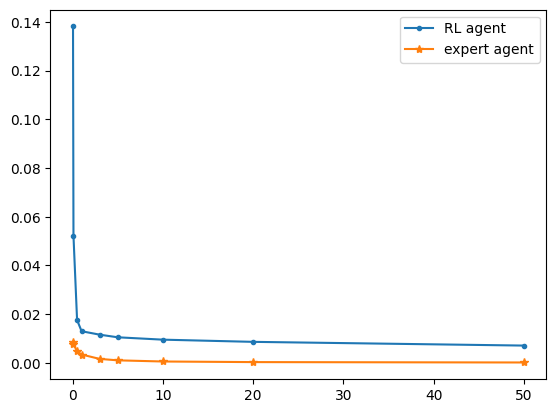

In [47]:
plt.plot(ratio_emax_pmax_list, scores[:, 0], marker=".", label="RL agent")
plt.plot(ratio_emax_pmax_list, scores[:, 1], marker="*", label="expert agent")
plt.legend()